# Some examples of code for testing and benchmarking: profiling

In [12]:
using Statistics
using Distributions
using LinearAlgebra
using CSV
using DataFrames

In [13]:
curPath = split(pwd(), "/")
newPath = curPath[1:(length(curPath))]
setPath = join(newPath,"/")
cd(setPath)

include("../code/graph_decomposition.jl")
include("../code/normalising_constant_mc.jl")
include("../code/laplace.jl")
include("../code/graph_prior.jl")
include("../code/graph_mutate_mcmc.jl")
include("../code/likelihood.jl")
include("../code/helperfunctions.jl")
include("../code/tempering.jl")
include("../code/particle_filter.jl")
include("../code/particle_MCMC.jl")

make_pairs (generic function with 1 method)

In [3]:
#set parameters

# struct hyper_pars
#     p::Int ## no of nodes
#   Tau::Int ## no of time instances
#     w::Float64 ## w in (0,1], gives E[no of edges]=p*w for G0
#     z::Float64 ## z in (0,1], gives E[no of edges flips]=p*z for G|Gp
# delta::Float64 ## delta>2 is parameter of G-Wishart(delta, D)
#   tau::Float64 ## tau>0 is s.t. D=tau*I in G-Wishart(delta,D)
# theta::Float64 # in [0,1], parameter of Geometric prior
#     g::Float64 #hyperparameter for geometric proposal
# end
# #############################
# struct MCMC_pars
#       M::Int ## no of MCMC steps
#      pB::Float64 ## p(Birth)
# end
# #############################
# struct PF_pars
#     N::Int ## no of particles
#  ESS0::Float64 ## ESS0 in (0,1) is threshold for ESS triggering resampling
#   TOL::Float64 ## tolerance level for bisection method convergence
#    nE::Int ## no of edges flipped at mutation step
#    nM::Int ## no of single MCMC steps synthesized to make up a mutation step
#    num_it::Int ## no of MC interations for normalising constant
#    Laplace::Bool ## true = use the Laplace method for computing norm const
#    is_parallel::Bool
#    master :: Int
# end
#############################
# struct Tree
#     G_yes::Array ## Sub graphs for decomposable components
#     D_yes::Array ## Sub matrices of D for decomposable components
#     G_no::Array ## Sub graphs for non-decomposable components
#     D_no::Array ## Sub matrices of D for decomposable components
#     G_sep::Array ## Sub graphs for decomposable separators
#     D_sep::Array ## Sub matrices of D for decomposable separators
# end

hyper = hyper_pars(10, 50, 0.5, 0.5, 3.0, 1.0/3.0, 0.5, 0.25)
parPF = PF_pars(100, 0.7, 0.001, 1, 5, 10, true, false, 0)
parMCMC = MCMC_pars(1, 0.5)

MCMC_pars(1, 0.5)

In [4]:
#generate data: example

Id = Matrix(1.0I, 10, 10)
y = zeros(50, 10)
distr0 = MvNormalCanon(Id)

for i in 1:50
    y[i,1:10] = rand(distr0)
end

In [5]:
#tun particle mcmc with printouts

function run_PMCMC()

    (S, timeseries_graphs, G, acc) = pseudo_MCMC([], hyper, y, parMCMC, parPF)

end

run_PMCMC (generic function with 1 method)

In [8]:
function get_time_PMCMC()
    @time run_PMCMC()
end

# run get_time_PMCMC(y, hyper, parPF, parMCMC) to get both printouts, time and memory usage

get_time_PMCMC (generic function with 1 method)

In [7]:
#run the particle filter alone

# pair = make_pairs(hyper) 
# temp = test_logl_est(S, hyper, Y, parPF, pair)
# logl_est(S, hyper, Y, parPF, temp, pair)

In [9]:
function run_PF(S, hyper, Y, parPF)
    
    pair = make_pairs(hyper) 
    temp = test_logl_est(S, hyper, Y, parPF, pair)
    (logl_SY, Gmean) = logl_est(S, hyper, Y, parPF, temp, pair)
    
    println("the likelihood of Y given S is = ", logl_SY)
    
    if (isnothing(S)==1) k = 0 else k = length(S) end
    
    for i in 1:(k+1)
        println("G mean for k = ", k, " = ", Gmean[i,:,:])
    end

    
end

run_PF (generic function with 1 method)

In [10]:
function get_time_PF(S, hyper, Y, parPF)
    
    @time run_PF(S, hyper, Y, parPF)
    
end

get_time_PF (generic function with 1 method)

# Profiling

In [6]:
using Profile

In [14]:
@profile run_PMCMC()

PMCMC iteration m = 1
proposal Spr = [38]
proposal type = Birth
logP(Y|Spr) =-773.8899728913345
log acceptance probability = -29.37614455006803


(Any[Any[], Any[]], [0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0; … ; 0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0]

[0.0 0.0 … 0.9999999999999996 0.9999999999999996; 0.0 0.0 … 0.9999999999999996 0.9999999999999996; … ; 0.0 0.0 … 0.9999999999999996 0.9999999999999996; 0.0 0.0 … 0.9999999999999996 0.9999999999999996]

[0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0; … ; 0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0]

[0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0; … ; 0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0]

[0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0; … ; 0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0]

[0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0; … ; 0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0]

[0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0; … ; 0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0]

[0.0 0.0 … 0.0 0.9999999999999996; 0.0 0.0 … 0.0 0.9999999999999996; … ; 0.0 0.0 … 0.0 0.9999999999999996; 0.0 0.0 … 0.0 0.9999999999999996]

[0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0; … ; 0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0]

[0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0; … ; 0.0 0.0 … 0.0 0.0; 

In [15]:
using ProfileVega

PMCMC iteration m = 1
proposal Spr = 

[22]
proposal type = Birth
logP(Y|Spr) =-790.9499641625208
log acceptance probability = -46.270786899920374


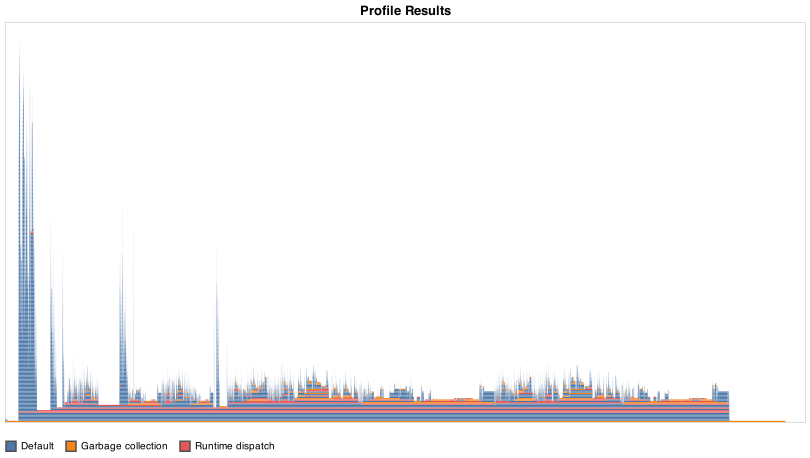

In [16]:
@profview run_PMCMC()

PMCMC iteration m = 1
proposal Spr = 

[15]
proposal type = Birth
logP(Y|Spr) =-802.6585809941855
log acceptance probability = -25.393880330662792


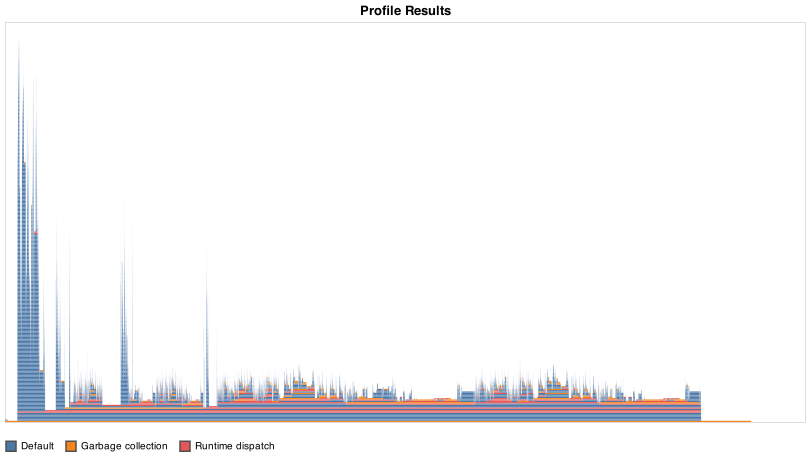

In [13]:
@profview run_PMCMC()

In [14]:
Profile.print()

Overhead ╎ [+additional indent] Count File:Line; Function
    ╎1     In[7]:5; run_PMCMC()
    ╎ 1     ...de/particle_MCMC.jl:109; pseudo_MCMC(::Array{Any,1}, ::...
    ╎  1     .../code/tempering.jl:101; test_logl_est(::Array{Any,1},...
    ╎   1     ...aph_mutate_mcmc.jl:46; mutate(::Array{Int64,3}, ::Bi...
    ╎    1     ...code/likelihood.jl:28; logp_GY(::BitArray{3}, ::hyp...
    ╎     1     ...ode/likelihood.jl:56; log_Iota(::BitArray{3}, ::Fl...
    ╎    ╎ 1     ...ode/likelihood.jl:183; logIno(::Array{BitArray{2},...
    ╎    ╎  1     .../code/laplace.jl:170; log_IG_laplace(::BitArray{...
    ╎    ╎   1     @Base/dict.jl:673; iterate
    ╎    ╎    1     @Base/dict.jl:669; _iterate
   1╎    ╎     1     @Base/pair.jl:12; Pair
   7╎7     @Base/abstractset.jl:420; mapfilter(::Base.var"#64#65"{B...
   1╎1     @Base/abstractset.jl:48; union(::Int64, ::Array{Int64,1})
   2╎2     @Base/array.jl:329; _copyto_impl!(::Array{Float64,...
   2╎2     @Base/array.jl:2561; _shrink(::Function, ::

    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +21 23    ...tation.jl:1270; typeinf_local(:...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +22 23    ...tation.jl:1005; abstract_eval(:...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +23 23    ...tation.jl:911; abstract_call(:...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +24 23    ...tation.jl:926; abstract_call(:...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +25 23    ...tation.jl:904; abstract_call_k...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +26 22    ...tation.jl:134; abstract_call_g...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +27 22    ...tation.jl:266; abstract_call_m...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +28 20    ...einfer.jl:12; typeinf(::Core....
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +29 20    ...tation.jl:1326; typeinf_nocycle...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +30 1     ...tation.jl:1255; typeinf_local(:...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +31 1     ...tation.jl:1005; abstract_eval(:...
    ╎    ╎    ╎    ╎    ╎   

    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +79 2     ...tation.jl:904; abstract_call_k...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +80 2     ...tation.jl:134; abstract_call_g...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +81 2     ...tation.jl:266; abstract_call_m...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +82 2     ...einfer.jl:12; typeinf(::Core....
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +83 2     ...tation.jl:1326; typeinf_nocycle...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +84 2     ...tation.jl:1270; typeinf_local(:...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +85 2     ...tation.jl:1005; abstract_eval(:...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +86 2     ...tation.jl:911; abstract_call(:...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +87 2     ...tation.jl:926; abstract_call(:...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +88 2     ...tation.jl:904; abstract_call_k...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +89 2     ...tation.jl:134; abstract_call_g...
    ╎    ╎    ╎    ╎    ╎    ╎

    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +95 1     ...tation.jl:911; abstract_call(:...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +96 1     ...tation.jl:926; abstract_call(:...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +97 1     ...tation.jl:904; abstract_call_k...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +98 1     ...tation.jl:55; abstract_call_g...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +99 1     ...iddict.jl:152; get!(::Core.Com...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎     +100 1     ...tation.jl:57; #216
   1╎    ╎    ╎    ╎    ╎    ╎    ╎     +101 1     ...ection.jl:861; _methods_by_ftype
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +82 1     ...einfer.jl:33; typeinf(::Core....
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +83 1     ...timize.jl:174; optimize(::Core...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +84 1     ...driver.jl:138; run_passes(::Co...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +85 1     ...lining.jl:77; ssa_inlining_pass!
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +86 1     

    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +37 2     ...einfer.jl:33; typeinf(::Core....
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +38 2     ...timize.jl:174; optimize(::Core...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +39 1     ...driver.jl:138; run_passes(::Co...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +40 1     ...lining.jl:77; ssa_inlining_pass!
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +41 1     ...lining.jl:552; batch_inline!(:...
   1╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +42 1     .../array.jl:0; ir_inline_item!...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +39 1     ...driver.jl:143; run_passes(::Co...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +40 1     ...passes.jl:553; getfield_elim_p...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +41 1     ...ueries.jl:85; is_known_call
   1╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +42 1     ...ueries.jl:71; compact_exprtype
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +28 2     ...einfer.jl:33; typeinf(::Core....
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +29 2

    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +48 5     ...tation.jl:419; abstract_call_m...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +49 5     ...einfer.jl:484; typeinf_edge(::...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +50 4     ...einfer.jl:12; typeinf(::Core....
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +51 4     ...tation.jl:1326; typeinf_nocycle...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +52 1     ...tation.jl:1255; typeinf_local(:...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +53 1     ...tation.jl:1005; abstract_eval(:...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +54 1     ...tation.jl:911; abstract_call(:...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +55 1     ...tation.jl:926; abstract_call(:...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +56 1     ...tation.jl:904; abstract_call_k...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +57 1     ...tation.jl:55; abstract_call_g...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +58 1     ...iddict.jl:152; get!(::Core.Com...
    ╎    ╎    ╎    ╎    ╎    ╎ 

    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +71 1     ...tation.jl:1005; abstract_eval(:...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +72 1     ...tation.jl:911; abstract_call(:...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +73 1     ...tation.jl:926; abstract_call(:...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +74 1     ...tation.jl:904; abstract_call_k...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +75 1     ...tation.jl:55; abstract_call_g...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +76 1     ...iddict.jl:152; get!(::Core.Com...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +77 1     ...tation.jl:57; #216
   1╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +78 1     ...ection.jl:861; _methods_by_ftype
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +35 5     ...tation.jl:904; abstract_call_k...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +36 5     ...tation.jl:134; abstract_call_g...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +37 5     ...tation.jl:266; abstract_call_m...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +38 4  

   1╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +26 1     ...attice.jl:206; widenconst(::Co...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +23 2     ...lining.jl:77; ssa_inlining_pass!
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +24 1     ...lining.jl:552; batch_inline!(:...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +25 1     ...lining.jl:396; ir_inline_item!...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +26 1     ...air/ir.jl:1155; iterate(::Core....
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +27 1     ...air/ir.jl:1003; finish_current_bb!
   1╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +28 1     ...air/ir.jl:1003; finish_current_...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +24 1     ...lining.jl:554; batch_inline!(:...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +25 1     ...lining.jl:439; ir_inline_union...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +26 1     ...air/ir.jl:668; insert_node_here!
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +27 1     ...air/ir.jl:681; insert_node_her...
    ╎    ╎    ╎    ╎    ╎    ╎ 

   1╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +12 1     ...einfer.jl:193; store_backedges...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎  +2 1     ...tation.jl:1270; typeinf_local(:...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎  +3 1     ...tation.jl:1005; abstract_eval(:...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎  +4 1     ...tation.jl:911; abstract_call(:...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎  +5 1     ...tation.jl:926; abstract_call(:...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎  +6 1     ...tation.jl:904; abstract_call_k...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎  +7 1     ...tation.jl:134; abstract_call_g...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎  +8 1     ...tation.jl:260; abstract_call_m...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎  +9 1     ...result.jl:12; InferenceResult
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +10 1     ...result.jl:47; matching_cache_...
   1╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +11 1     .../tuple.jl:81; indexed_iterate
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    

    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎  +4 2     ...tation.jl:911; abstract_call(:...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎  +5 2     ...tation.jl:926; abstract_call(:...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎  +6 2     ...tation.jl:904; abstract_call_k...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎  +7 2     ...tation.jl:134; abstract_call_g...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎  +8 2     ...tation.jl:266; abstract_call_m...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎  +9 1     ...einfer.jl:12; typeinf(::Core....
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +10 1     ...tation.jl:1326; typeinf_nocycle...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +11 1     ...tation.jl:1270; typeinf_local(:...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +12 1     ...tation.jl:1005; abstract_eval(:...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +13 1     ...tation.jl:911; abstract_call(:...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +14 1     ...tation.jl:926; abstract_call(:...
    ╎    ╎    ╎    ╎    ╎    ╎

    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +17 4     ...einfer.jl:12; typeinf(::Core....
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +18 4     ...tation.jl:1326; typeinf_nocycle...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +19 4     ...tation.jl:1270; typeinf_local(:...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +20 4     ...tation.jl:1005; abstract_eval(:...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +21 4     ...tation.jl:911; abstract_call(:...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +22 4     ...tation.jl:926; abstract_call(:...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +23 4     ...tation.jl:904; abstract_call_k...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +24 4     ...tation.jl:134; abstract_call_g...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +25 4     ...tation.jl:266; abstract_call_m...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +26 3     ...einfer.jl:12; typeinf(::Core....
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +27 3     ...tation.jl:1326; typeinf_nocycle...
    ╎    ╎    ╎    ╎    ╎    ╎

    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎    2     ...einfer.jl:33; typeinf(::Core....
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎     2     ...timize.jl:174; optimize(::Core...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎  +1 2     ...driver.jl:138; run_passes(::Co...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎  +2 2     ...lining.jl:74; ssa_inlining_pass!
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎  +3 1     ...lining.jl:999; assemble_inline...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎  +4 1     ...lining.jl:982; process_simple!...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎  +5 1     ...lining.jl:20; with_atype
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎  +6 1     ...eutils.jl:46; argtypes_to_type
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎  +7 1     ...lities.jl:39; anymap(::typeof...
   1╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎  +8 1     ...attice.jl:206; widenconst(::Co...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎  +3 1     ...lining.jl:1039; assemble_inline...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎  +4 1 

   1╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +25 1     ...e/boot.jl:406; Array
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +23 1     ...ot2ssa.jl:626; construct_ssa!(...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +24 1     ...ot2ssa.jl:537; compute_live_in...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +25 1     .../array.jl:2459; filter(::Core.C...
   1╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +26 1     ...e/boot.jl:406; Array
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +12 8     ...tation.jl:1270; typeinf_local(:...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +13 8     ...tation.jl:1005; abstract_eval(:...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +14 8     ...tation.jl:911; abstract_call(:...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +15 8     ...tation.jl:926; abstract_call(:...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +16 1     ...tation.jl:720; abstract_call_k...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +17 1     ...tfuncs.jl:1342; builtin_tfunction
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +18 1     ...t

    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +60 1     ...tation.jl:926; abstract_call(:...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +61 1     ...tation.jl:904; abstract_call_k...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +62 1     ...tation.jl:55; abstract_call_g...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +63 1     ...iddict.jl:152; get!(::Core.Com...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +64 1     ...tation.jl:57; #216
   1╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +65 1     ...ection.jl:861; _methods_by_ftype
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +19 1     ...einfer.jl:33; typeinf(::Core....
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +20 1     ...timize.jl:174; optimize(::Core...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +21 1     ...driver.jl:138; run_passes(::Co...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +22 1     ...lining.jl:74; ssa_inlining_pass!
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +23 1     ...lining.jl:999; assemble_inline...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +24 1     

   1╎    ╎    ╎    ╎    ╎  1     ...peinfer.jl:201; widen_all_consts!...
    ╎    ╎    ╎  174   ...erpretation.jl:1270; typeinf_local(::Core.C...
    ╎    ╎    ╎   174   ...rpretation.jl:1005; abstract_eval(::Any, :...
    ╎    ╎    ╎    174   ...rpretation.jl:911; abstract_call(::Array{...
    ╎    ╎    ╎     174   ...rpretation.jl:926; abstract_call(::Array...
    ╎    ╎    ╎    ╎ 1     ...rpretation.jl:903; abstract_call_known(:...
    ╎    ╎    ╎    ╎  1     .../typeutils.jl:46; argtypes_to_type
    ╎    ╎    ╎    ╎   1     ...utilities.jl:39; anymap(::typeof(Core...
   1╎    ╎    ╎    ╎    1     ...elattice.jl:206; widenconst(::Core.C...
    ╎    ╎    ╎    ╎ 173   ...rpretation.jl:904; abstract_call_known(:...
    ╎    ╎    ╎    ╎  1     ...pretation.jl:55; abstract_call_gf_by_...
    ╎    ╎    ╎    ╎   1     @Base/iddict.jl:152; get!(::Core.Compile...
    ╎    ╎    ╎    ╎    1     ...pretation.jl:57; #216
   1╎    ╎    ╎    ╎     1     ...flection.jl:861; _methods_by_ftype
    ╎ 

    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +42 1     .../array.jl:525; zeros
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +43 1     ...e/boot.jl:415; Array
   1╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +44 1     ...e/boot.jl:406; Array
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +17 1     ...einfer.jl:21; typeinf(::Core....
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +18 1     ...einfer.jl:149; finish
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +19 1     ...einfer.jl:311; type_annotate!(...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +20 1     .../array.jl:471; fill
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +21 1     .../array.jl:473; fill
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +22 1     ...e/boot.jl:415; Array
   1╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +23 1     ...e/boot.jl:406; Array
    ╎    ╎    ╎    ╎    ╎    ╎    ╎  4     ...tation.jl:1270; typeinf_local(:...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎   4     ...tation.jl:1005; abstract_eval(:...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    4     ...tation.jl:911; 

    ╎    ╎    ╎    ╎    ╎    ╎    ╎ 3     ...timize.jl:174; optimize(::Core...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎  3     ...driver.jl:138; run_passes(::Co...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎   2     ...lining.jl:74; ssa_inlining_pass!
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    1     ...lining.jl:1013; assemble_inline...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎     1     ...iddict.jl:144; get(::Core.Comp...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ 1     ...lining.jl:1021; #351
   1╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎  1     ...ection.jl:861; _methods_by_ftype
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    1     ...lining.jl:1046; assemble_inline...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎     1     ...lining.jl:669; analyze_method!...
   1╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ 1     ...attice.jl:206; widenconst(::Co...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎   1     ...lining.jl:77; ssa_inlining_pass!
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    1     ...lining.jl:552; batch_inline!(:...
   1╎    ╎    ╎    ╎    ╎   

    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +71 1     ...timize.jl:174; optimize(::Core...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +72 1     ...driver.jl:140; run_passes(::Co...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +73 1     ...air/ir.jl:1296; compact!
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +74 1     ...air/ir.jl:1296; compact!(::Core...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +75 1     ...air/ir.jl:492; Core.Compiler.I...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +76 1     ...e/boot.jl:420; Array
   1╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +77 1     ...e/boot.jl:406; Array
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +43 1     ...einfer.jl:33; typeinf(::Core....
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +44 1     ...timize.jl:174; optimize(::Core...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +45 1     ...driver.jl:138; run_passes(::Co...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +46 1     ...lining.jl:74; ssa_inlining_pass!
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +47 1     ...lining.jl:1046

    ╎    ╎    ╎    ╎    ╎    ╎ 1     ...lining.jl:20; with_atype
    ╎    ╎    ╎    ╎    ╎    ╎  1     ...eutils.jl:46; argtypes_to_type
    ╎    ╎    ╎    ╎    ╎    ╎   1     ...lities.jl:39; anymap(::typeof...
   1╎    ╎    ╎    ╎    ╎    ╎    1     ...attice.jl:206; widenconst(::Co...
    ╎    ╎    ╎    ╎    ╎    1     ...lining.jl:1013; assemble_inline...
    ╎    ╎    ╎    ╎    ╎     1     ...iddict.jl:144; get(::Core.Comp...
    ╎    ╎    ╎    ╎    ╎    ╎ 1     ...lining.jl:1021; #351
   1╎    ╎    ╎    ╎    ╎    ╎  1     ...ection.jl:861; _methods_by_ftype
    ╎    ╎    ╎    ╎    ╎    4     ...lining.jl:1046; assemble_inline...
    ╎    ╎    ╎    ╎    ╎     1     ...lining.jl:708; analyze_method!...
   1╎    ╎    ╎    ╎    ╎    ╎ 1     ...lining.jl:1301; find_inferred(:...
    ╎    ╎    ╎    ╎    ╎     2     ...lining.jl:736; analyze_method!...
    ╎    ╎    ╎    ╎    ╎    ╎ 1     ...legacy.jl:6; inflate_ir(::Co...
   1╎    ╎    ╎    ╎    ╎    ╎  1     ...result.jl:70; matching_

    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +14 2     ...tation.jl:266; abstract_call_m...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +15 2     ...einfer.jl:12; typeinf(::Core....
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +16 2     ...tation.jl:1326; typeinf_nocycle...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +17 2     ...tation.jl:1270; typeinf_local(:...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +18 2     ...tation.jl:1005; abstract_eval(:...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +19 2     ...tation.jl:911; abstract_call(:...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +20 2     ...tation.jl:926; abstract_call(:...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +21 2     ...tation.jl:904; abstract_call_k...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +22 2     ...tation.jl:134; abstract_call_g...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +23 2     ...tation.jl:266; abstract_call_m...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +24 1     ...einfer.jl:12; typeinf(::Core....
    ╎    ╎    ╎    ╎    ╎    ╎ 

    ╎    ╎    ╎    3     ...r/inlining.jl:999; assemble_inline_todo!(...
    ╎    ╎    ╎     1     ...r/inlining.jl:956; process_simple!(::Cor...
    ╎    ╎    ╎    ╎ 1     ...r/inlining.jl:872; call_sig(::Core.Compi...
    ╎    ╎    ╎    ╎  1     ...utilities.jl:158; argextype
    ╎    ╎    ╎    ╎   1     ...utilities.jl:178; argextype(::Any, ::...
    ╎    ╎    ╎    ╎    1     ...retation.jl:1128; abstract_eval_global
   1╎    ╎    ╎    ╎     1     ...flection.jl:240; isconst
    ╎    ╎    ╎     2     ...r/inlining.jl:982; process_simple!(::Cor...
    ╎    ╎    ╎    ╎ 2     ...r/inlining.jl:20; with_atype
   2╎    ╎    ╎    ╎  2     ...r/inlining.jl:18; Core.Compiler.Signatu...
    ╎    ╎    ╎   1     ...ir/inlining.jl:77; ssa_inlining_pass!
    ╎    ╎    ╎    1     ...r/inlining.jl:552; batch_inline!(::Array{...
   1╎    ╎    ╎     1     @Base/array.jl:0; ir_inline_item!(::Core...
    ╎    ╎    ╎  1     ...sair/driver.jl:143; run_passes(::Core.CodeI...
    ╎    ╎    ╎   1     ...sai

    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +50 1     ...timize.jl:256; optimize(::Core...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +51 1     ...timize.jl:148; isinlineable(::...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +52 1     ...timize.jl:380; inline_worthy
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +53 1     ...timize.jl:291; statement_cost(...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +54 1     ...lities.jl:178; argextype(::Any...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +55 1     ...tation.jl:1128; abstract_eval_g...
   1╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +56 1     ...ection.jl:240; isconst
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +40 1     ...einfer.jl:33; typeinf(::Core....
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +41 1     ...timize.jl:174; optimize(::Core...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +42 1     ...driver.jl:138; run_passes(::Co...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +43 1     ...lining.jl:74; ssa_inlining_pass!
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +44 1   

    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +87 2     ...tation.jl:926; abstract_call(:...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +88 2     ...tation.jl:904; abstract_call_k...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +89 2     ...tation.jl:134; abstract_call_g...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +90 2     ...tation.jl:266; abstract_call_m...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +91 1     ...einfer.jl:12; typeinf(::Core....
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +92 1     ...tation.jl:1326; typeinf_nocycle...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +93 1     ...tation.jl:1270; typeinf_local(:...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +94 1     ...tation.jl:1005; abstract_eval(:...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +95 1     ...tation.jl:911; abstract_call(:...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +96 1     ...tation.jl:926; abstract_call(:...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +97 1     ...tation.jl:904; abstract_call_k...
    ╎    ╎    ╎    ╎    ╎    ╎

    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +79 1     ...tation.jl:904; abstract_call_k...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +80 1     ...tation.jl:134; abstract_call_g...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +81 1     ...tation.jl:266; abstract_call_m...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +82 1     ...einfer.jl:21; typeinf(::Core....
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +83 1     ...einfer.jl:149; finish
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +84 1     ...einfer.jl:337; type_annotate!(...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +85 1     ...einfer.jl:231; annotate_slot_l...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +86 1     ...einfer.jl:245; visit_slot_load...
   1╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +87 1     ...attice.jl:173; ⊑(::Any, ::Any)
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +64 1     ...einfer.jl:33; typeinf(::Core....
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +65 1     ...timize.jl:174; optimize(::Core...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +66 1   

    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎  +1 1     ...tation.jl:57; #216
   1╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎  +2 1     ...ection.jl:861; _methods_by_ftype
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎    3     ...tation.jl:134; abstract_call_g...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎     3     ...tation.jl:266; abstract_call_m...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎  +1 3     ...einfer.jl:12; typeinf(::Core....
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎  +2 3     ...tation.jl:1326; typeinf_nocycle...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎  +3 3     ...tation.jl:1270; typeinf_local(:...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎  +4 3     ...tation.jl:1005; abstract_eval(:...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎  +5 3     ...tation.jl:911; abstract_call(:...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎  +6 3     ...tation.jl:926; abstract_call(:...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎  +7 2     ...tation.jl:704; abstract_call_k...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎  +8 2 

    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎  +5 1     ...tation.jl:926; abstract_call(:...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎  +6 1     ...tation.jl:904; abstract_call_k...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎  +7 1     ...tation.jl:134; abstract_call_g...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎  +8 1     ...tation.jl:266; abstract_call_m...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎  +9 1     ...einfer.jl:33; typeinf(::Core....
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +10 1     ...timize.jl:174; optimize(::Core...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +11 1     ...driver.jl:138; run_passes(::Co...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +12 1     ...lining.jl:74; ssa_inlining_pass!
   1╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +13 1     ...lining.jl:1033; assemble_inline...
    ╎    ╎    ╎    ╎    ╎  1     ...ypeinfer.jl:33; typeinf(::Core.Com...
    ╎    ╎    ╎    ╎    ╎   1     ...ptimize.jl:174; optimize(::Core....
    ╎    ╎    ╎    ╎    ╎    1     ...driver.jl:138; run_passe

   1╎    ╎    ╎    ╎   1     @Base/array.jl:809; getindex
    ╎    ╎     2981  ...e/likelihood.jl:25; logp_GY(::BitArray{3}, :...
    ╎    ╎    ╎ 1127  ...e/likelihood.jl:51; log_Iota(::BitArray{3}, ...
  16╎    ╎    ╎  1114  .../likelihood.jl:84; decompose_G(::BitArray{...
  83╎    ╎    ╎   107   ...composition.jl:276; decompose_graph(::Arra...
    ╎    ╎    ╎    4     ...composition.jl:66; max_cardinality_search...
    ╎    ╎    ╎     1     ...omposition.jl:38; find_neighbours(::Arra...
    ╎    ╎    ╎    ╎ 1     @Base/dict.jl:90; Dict{Int64,Array{Int6...
   1╎    ╎    ╎    ╎  1     @Base/boot.jl:406; Array
    ╎    ╎    ╎     3     ...omposition.jl:40; find_neighbours(::Arra...
    ╎    ╎    ╎    ╎ 2     ...ractarray.jl:1060; getindex
    ╎    ╎    ╎    ╎  2     ...mensional.jl:743; _getindex
   2╎    ╎    ╎    ╎   2     ...mensional.jl:752; _unsafe_getindex(::...
    ╎    ╎    ╎    ╎ 1     @Base/array.jl:2108; findall
    ╎    ╎    ╎    ╎  1     @Base/array.jl:684; collect
   1╎   

    ╎    ╎    ╎    ╎    ╎    ╎    ╎ 1     ...e/dict.jl:168; hashindex
    ╎    ╎    ╎    ╎    ╎    ╎    ╎  1     ...ashing.jl:18; hash
    ╎    ╎    ╎    ╎    ╎    ╎    ╎   1     .../float.jl:572; hash
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    1     .../float.jl:568; hx
    ╎    ╎    ╎    ╎    ╎    ╎    ╎     1     ...ashing.jl:62; hash_uint64
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ 1     ...ashing.jl:31; hash_64_64
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎  1     ...rators.jl:538; +
   1╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎   1     @Base/int.jl:86; +
    ╎    ╎    ╎    ╎    ╎  2     @Base/set.jl:35; emptymutable
    ╎    ╎    ╎    ╎    ╎   2     @Base/set.jl:6; Set
    ╎    ╎    ╎    ╎    ╎    2     @Base/dict.jl:90; Dict{Int64,Nothi...
    ╎    ╎    ╎    ╎    ╎     2     .../array.jl:521; zeros
    ╎    ╎    ╎    ╎    ╎    ╎ 2     .../array.jl:525; zeros
    ╎    ╎    ╎    ╎    ╎    ╎  2     ...e/boot.jl:415; Array
   2╎    ╎    ╎    ╎    ╎    ╎   2     ...e/boot.jl:406; Array
    ╎    ╎

   1╎    ╎    ╎    ╎    ╎  1     @Base/boot.jl:406; Array
    ╎    ╎    ╎    ╎   1     @Base/set.jl:21; Set
    ╎    ╎    ╎    ╎    1     @Base/set.jl:23; _Set
    ╎    ╎    ╎    ╎     1     @Base/set.jl:10; Set
    ╎    ╎    ╎    ╎    ╎ 1     @Base/set.jl:6; Set
    ╎    ╎    ╎    ╎    ╎  1     @Base/dict.jl:90; Dict{Int64,Nothing}()
    ╎    ╎    ╎    ╎    ╎   1     ...e/array.jl:521; zeros
    ╎    ╎    ╎    ╎    ╎    1     .../array.jl:525; zeros
    ╎    ╎    ╎    ╎    ╎     1     ...e/boot.jl:415; Array
   1╎    ╎    ╎    ╎    ╎    ╎ 1     ...e/boot.jl:406; Array
    ╎    ╎    ╎    ╎  1     @Base/array.jl:2563; _shrink(::Function,...
    ╎    ╎    ╎    ╎   1     @Base/array.jl:2532; _shrink_filter!
   1╎    ╎    ╎    ╎    1     @Base/array.jl:2522; _unique_filter!
    ╎    ╎    ╎     1     ...omposition.jl:209; (::Main.graph_decompo...
    ╎    ╎    ╎    ╎ 1     @Base/array.jl:941; push!
   1╎    ╎    ╎    ╎  1     @Base/array.jl:892; _growend!
    ╎    ╎    ╎     4     ...omposi

    ╎    ╎    ╎    ╎   106   ...generator.jl:47; iterate
   1╎    ╎    ╎    ╎    106   none:0; (::Main.graph_decomp...
   3╎    ╎    ╎    ╎     51    @Base/array.jl:2566; intersect(::Array{...
   1╎    ╎    ╎    ╎    ╎ 27    ...e/array.jl:2562; _shrink(::Functio...
    ╎    ╎    ╎    ╎    ╎  16    ...ractset.jl:139; intersect!(::Set{...
    ╎    ╎    ╎    ╎    ╎   2     ...ractset.jl:138; intersect!
    ╎    ╎    ╎    ╎    ╎    2     @Base/set.jl:390; filter!
    ╎    ╎    ╎    ╎    ╎     2     ...actset.jl:417; unsafe_filter!
    ╎    ╎    ╎    ╎    ╎    ╎ 2     ...actset.jl:422; mapfilter(::Bas...
    ╎    ╎    ╎    ╎    ╎    ╎  2     ...rators.jl:896; #64
    ╎    ╎    ╎    ╎    ╎    ╎   2     ...actset.jl:46; #261
    ╎    ╎    ╎    ╎    ╎    ╎    2     @Base/set.jl:56; in
    ╎    ╎    ╎    ╎    ╎    ╎     2     ...e/dict.jl:535; haskey
   2╎    ╎    ╎    ╎    ╎    ╎    ╎ 2     ...e/dict.jl:286; ht_keyindex(::D...
    ╎    ╎    ╎    ╎    ╎   4     ...ractset.jl:91; union!(::Set{In

    ╎    ╎    ╎    ╎    ╎    1     ...e/sort.jl:733; sort!(::Array{In...
    ╎    ╎    ╎    ╎    ╎     1     ...e/sort.jl:673; sort!
    ╎    ╎    ╎    ╎    ╎    ╎ 1     ...e/sort.jl:565; sort!(::Array{I...
   1╎    ╎    ╎    ╎    ╎    ╎  1     ...e/sort.jl:507; sort!(::Array{I...
    ╎    ╎    ╎    ╎     22    ...position.jl:242; (::Main.graph_deco...
    ╎    ╎    ╎    ╎    ╎ 1     ...ctarray.jl:1060; getindex
    ╎    ╎    ╎    ╎    ╎  1     ...nsional.jl:743; _getindex
    ╎    ╎    ╎    ╎    ╎   1     ...nsional.jl:754; _unsafe_getindex...
    ╎    ╎    ╎    ╎    ╎    1     ...sional.jl:623; index_shape
    ╎    ╎    ╎    ╎    ╎     1     ...sional.jl:623; index_shape
    ╎    ╎    ╎    ╎    ╎    ╎ 1     ...tarray.jl:75; axes
    ╎    ╎    ╎    ╎    ╎    ╎  1     .../tuple.jl:157; map
    ╎    ╎    ╎    ╎    ╎    ╎   1     .../range.jl:326; OneTo
    ╎    ╎    ╎    ╎    ╎    ╎    1     .../range.jl:317; OneTo
   1╎    ╎    ╎    ╎    ╎    ╎     1     ...motion.jl:409; max
    ╎    

    ╎    ╎    ╎    ╎  4     .../typeinfer.jl:12; typeinf(::Core.Compil...
    ╎    ╎    ╎    ╎   4     ...retation.jl:1326; typeinf_nocycle(::C...
    ╎    ╎    ╎    ╎    1     ...retation.jl:1255; typeinf_local(::Co...
    ╎    ╎    ╎    ╎     1     ...retation.jl:1005; abstract_eval(::An...
    ╎    ╎    ╎    ╎    ╎ 1     ...retation.jl:911; abstract_call(::Ar...
    ╎    ╎    ╎    ╎    ╎  1     ...etation.jl:926; abstract_call(::A...
    ╎    ╎    ╎    ╎    ╎   1     ...etation.jl:851; abstract_call_kn...
    ╎    ╎    ╎    ╎    ╎    1     ...tfuncs.jl:1524; return_type_tfu...
    ╎    ╎    ╎    ╎    ╎     1     ...tation.jl:926; abstract_call(:...
    ╎    ╎    ╎    ╎    ╎    ╎ 1     ...tation.jl:904; abstract_call_k...
    ╎    ╎    ╎    ╎    ╎    ╎  1     ...tation.jl:111; abstract_call_g...
    ╎    ╎    ╎    ╎    ╎    ╎   1     ...tation.jl:419; abstract_call_m...
    ╎    ╎    ╎    ╎    ╎    ╎    1     ...einfer.jl:484; typeinf_edge(::...
    ╎    ╎    ╎    ╎    ╎    ╎     1  

    ╎    ╎    ╎    ╎  3     @Base/array.jl:2532; _shrink_filter!
   3╎    ╎    ╎    ╎   3     @Base/array.jl:2522; _unique_filter!
    ╎    ╎    ╎    ╎  1     @Base/array.jl:2558; vectorfilter(::Func...
    ╎    ╎    ╎    ╎   1     @Base/array.jl:2462; filter(::Base.var"#...
    ╎    ╎    ╎    ╎    1     @Base/array.jl:2523; #89
    ╎    ╎    ╎    ╎     1     @Base/set.jl:56; in
    ╎    ╎    ╎    ╎    ╎ 1     @Base/dict.jl:535; haskey
   1╎    ╎    ╎    ╎    ╎  1     @Base/dict.jl:286; ht_keyindex(::Dic...
   2╎    ╎    ╎    7     ...omposition.jl:257; min_deficiency_search(...
    ╎    ╎    ╎     4     ...bstractset.jl:48; union(::Int64, ::Arra...
    ╎    ╎    ╎    ╎ 1     ...ractarray.jl:696; emptymutable
    ╎    ╎    ╎    ╎  1     @Base/boot.jl:425; Array
   1╎    ╎    ╎    ╎   1     @Base/boot.jl:406; Array
    ╎    ╎    ╎    ╎ 3     @Base/array.jl:2542; union!
   1╎    ╎    ╎    ╎  3     @Base/array.jl:2537; _grow!(::Function, ...
    ╎    ╎    ╎    ╎   2     ...stractset.jl:42

    ╎    ╎    ╎    ╎    ╎     1     ...e/dict.jl:294; ht_keyindex(::D...
   1╎    ╎    ╎    ╎    ╎    ╎ 1     @Base/int.jl:86; +
    ╎    ╎    ╎    ╎    2     @Base/array.jl:751; grow_to!(::Array{In...
    ╎    ╎    ╎    ╎     2     @Base/array.jl:778; grow_to!(::Array{I...
    ╎    ╎    ╎    ╎    ╎ 2     ...enerator.jl:44; iterate
    ╎    ╎    ╎    ╎    ╎  2     ...erators.jl:431; iterate(::Base.It...
    ╎    ╎    ╎    ╎    ╎   2     .../array.jl:2523; #89
    ╎    ╎    ╎    ╎    ╎    2     @Base/set.jl:56; in
    ╎    ╎    ╎    ╎    ╎     2     ...e/dict.jl:535; haskey
    ╎    ╎    ╎    ╎    ╎    ╎ 2     ...e/dict.jl:282; ht_keyindex(::D...
    ╎    ╎    ╎    ╎    ╎    ╎  2     ...e/dict.jl:168; hashindex
    ╎    ╎    ╎    ╎    ╎    ╎   2     ...ashing.jl:18; hash
    ╎    ╎    ╎    ╎    ╎    ╎    2     .../float.jl:572; hash
    ╎    ╎    ╎    ╎    ╎    ╎     2     .../float.jl:568; hx
    ╎    ╎    ╎    ╎    ╎    ╎    ╎ 2     ...ashing.jl:62; hash_uint64
    ╎    ╎    ╎    ╎   

    ╎    ╎    ╎    ╎    ╎    ╎  1     ...actset.jl:422; mapfilter(::Bas...
    ╎    ╎    ╎    ╎    ╎    ╎   1     .../array.jl:935; push!
   1╎    ╎    ╎    ╎    ╎    ╎    1     .../array.jl:892; _growend!
    ╎    ╎    ╎    45    @Base/array.jl:691; collect(::Base.Generat...
    ╎    ╎    ╎     45    @Base/array.jl:710; collect_to_with_first...
    ╎    ╎    ╎    ╎ 45    @Base/array.jl:732; collect_to!(::Array{A...
    ╎    ╎    ╎    ╎  45    .../generator.jl:47; iterate
   5╎    ╎    ╎    ╎   45    none:0; (::Main.graph_decompo...
   1╎    ╎    ╎    ╎    1     @Base/array.jl:371; copy(::Array{Array...
    ╎    ╎    ╎    ╎    34    @Base/array.jl:2507; filter!(::Main.gra...
   2╎    ╎    ╎    ╎     34    ...position.jl:286; (::Main.graph_deco...
    ╎    ╎    ╎    ╎    ╎ 30    ...e/array.jl:2566; intersect
    ╎    ╎    ╎    ╎    ╎  20    ...e/array.jl:2562; _shrink(::Functi...
   1╎    ╎    ╎    ╎    ╎   17    ...ractset.jl:139; intersect!(::Set...
    ╎    ╎    ╎    ╎    ╎    3     

    ╎    ╎    ╎    ╎    ╎    ╎    ╎    1     ...ashing.jl:33; hash_64_64
    ╎    ╎    ╎    ╎    ╎    ╎    ╎     1     ...rators.jl:538; +
   1╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ 1     @Base/int.jl:86; +
   1╎    ╎    ╎    ╎    ╎    ╎   1     ...e/dict.jl:286; ht_keyindex(::D...
    ╎    ╎    ╎    ╎    1     @Base/set.jl:21; Set
    ╎    ╎    ╎    ╎     1     @Base/set.jl:23; _Set
    ╎    ╎    ╎    ╎    ╎ 1     @Base/set.jl:10; Set
   1╎    ╎    ╎    ╎    ╎  1     @Base/set.jl:6; Set
    ╎    ╎    ╎    19    @Base/array.jl:691; collect(::Base.Generat...
    ╎    ╎    ╎     19    @Base/array.jl:710; collect_to_with_first!
    ╎    ╎    ╎    ╎ 19    @Base/array.jl:732; collect_to!(::Array{B...
    ╎    ╎    ╎    ╎  19    .../generator.jl:47; iterate
    ╎    ╎    ╎    ╎   19    none:0; #26
    ╎    ╎    ╎    ╎    19    @Base/array.jl:2566; intersect
    ╎    ╎    ╎    ╎     14    @Base/array.jl:2562; _shrink(::Function...
    ╎    ╎    ╎    ╎    ╎ 9     ...tractset.jl:139; intersect!(:

    ╎    ╎    ╎    ╎    ╎   10    @Base/set.jl:10; Set
    ╎    ╎    ╎    ╎    ╎    10    @Base/set.jl:6; Set
    ╎    ╎    ╎    ╎    ╎     10    ...e/dict.jl:90; Dict{Int64,Nothi...
    ╎    ╎    ╎    ╎    ╎    ╎ 4     .../array.jl:521; zeros
    ╎    ╎    ╎    ╎    ╎    ╎  4     .../array.jl:525; zeros
    ╎    ╎    ╎    ╎    ╎    ╎   4     ...e/boot.jl:415; Array
   4╎    ╎    ╎    ╎    ╎    ╎    4     ...e/boot.jl:406; Array
   6╎    ╎    ╎    ╎    ╎    ╎ 6     ...e/boot.jl:406; Array
    ╎    ╎    ╎    ╎     25    @Base/array.jl:2563; _shrink(::Function...
    ╎    ╎    ╎    ╎    ╎ 11    ...e/array.jl:2532; _shrink_filter!
  11╎    ╎    ╎    ╎    ╎  11    ...e/array.jl:2522; _unique_filter!
    ╎    ╎    ╎    ╎    ╎ 14    ...e/array.jl:2558; vectorfilter(::Fu...
    ╎    ╎    ╎    ╎    ╎  6     ...e/array.jl:2459; filter(::Base.va...
   6╎    ╎    ╎    ╎    ╎   6     @Base/boot.jl:406; Array
    ╎    ╎    ╎    ╎    ╎  8     ...e/array.jl:2462; filter(::Base.va...
   1╎    ╎    ╎  

    ╎    ╎    ╎    ╎    ╎    ╎ 1     @Base/int.jl:447; <
   1╎    ╎    ╎    ╎    ╎    ╎  1     ...e/bool.jl:40; &
    ╎    ╎    ╎    ╎    ╎    40    @Base/set.jl:35; emptymutable
    ╎    ╎    ╎    ╎    ╎     40    @Base/set.jl:6; Set
  13╎    ╎    ╎    ╎    ╎    ╎ 40    ...e/dict.jl:90; Dict{Int64,Noth...
    ╎    ╎    ╎    ╎    ╎    ╎  5     .../array.jl:521; zeros
    ╎    ╎    ╎    ╎    ╎    ╎   5     .../array.jl:525; zeros
    ╎    ╎    ╎    ╎    ╎    ╎    5     ...e/boot.jl:415; Array
   5╎    ╎    ╎    ╎    ╎    ╎     5     ...e/boot.jl:406; Array
  22╎    ╎    ╎    ╎    ╎    ╎  22    ...e/boot.jl:406; Array
    ╎    ╎    ╎    ╎    ╎   59    @Base/set.jl:21; Set
    ╎    ╎    ╎    ╎    ╎    59    @Base/set.jl:23; _Set
    ╎    ╎    ╎    ╎    ╎     59    @Base/set.jl:10; Set
    ╎    ╎    ╎    ╎    ╎    ╎ 16    ...actset.jl:91; union!(::Set{In...
    ╎    ╎    ╎    ╎    ╎    ╎  16    @Base/set.jl:57; push!
    ╎    ╎    ╎    ╎    ╎    ╎   10    ...e/dict.jl:381; setindex!(::Dic.

    ╎    ╎    ╎    ╎    ╎    ╎ 1     ...tation.jl:926; abstract_call(:...
    ╎    ╎    ╎    ╎    ╎    ╎  1     ...tation.jl:904; abstract_call_k...
    ╎    ╎    ╎    ╎    ╎    ╎   1     ...tation.jl:111; abstract_call_g...
    ╎    ╎    ╎    ╎    ╎    ╎    1     ...tation.jl:419; abstract_call_m...
    ╎    ╎    ╎    ╎    ╎    ╎     1     ...einfer.jl:484; typeinf_edge(::...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎ 1     ...einfer.jl:21; typeinf(::Core....
    ╎    ╎    ╎    ╎    ╎    ╎    ╎  1     ...einfer.jl:149; finish
   1╎    ╎    ╎    ╎    ╎    ╎    ╎   1     ...einfer.jl:295; type_annotate!(...
    ╎    ╎    ╎    ╎    ╎    1     ...tation.jl:904; abstract_call_kn...
    ╎    ╎    ╎    ╎    ╎     1     ...tation.jl:55; abstract_call_gf...
    ╎    ╎    ╎    ╎    ╎    ╎ 1     ...iddict.jl:152; get!(::Core.Com...
    ╎    ╎    ╎    ╎    ╎    ╎  1     ...tation.jl:57; #216
   1╎    ╎    ╎    ╎    ╎    ╎   1     ...ection.jl:861; _methods_by_ftype
    ╎    ╎    ╎    ╎     2     ...reta

    ╎    ╎    ╎    ╎    ╎    1     ...e/dict.jl:645; delete!(::Dict{I...
    ╎    ╎    ╎    ╎    ╎     1     ...e/dict.jl:282; ht_keyindex(::D...
    ╎    ╎    ╎    ╎    ╎    ╎ 1     ...e/dict.jl:168; hashindex
    ╎    ╎    ╎    ╎    ╎    ╎  1     ...ashing.jl:18; hash
    ╎    ╎    ╎    ╎    ╎    ╎   1     .../float.jl:572; hash
    ╎    ╎    ╎    ╎    ╎    ╎    1     .../float.jl:568; hx
    ╎    ╎    ╎    ╎    ╎    ╎     1     ...ashing.jl:62; hash_uint64
    ╎    ╎    ╎    ╎    ╎    ╎    ╎ 1     ...ashing.jl:32; hash_64_64
    ╎    ╎    ╎    ╎    ╎    ╎    ╎  1     @Base/int.jl:461; >>
   1╎    ╎    ╎    ╎    ╎    ╎    ╎   1     @Base/int.jl:455; >>
    ╎    ╎    ╎    ╎    ╎   1     @Base/set.jl:78; iterate
    ╎    ╎    ╎    ╎    ╎    1     ...e/dict.jl:683; iterate
   1╎    ╎    ╎    ╎    ╎     1     ...motion.jl:398; ==
    ╎    ╎    ╎    ╎    1     ...tractset.jl:89; union!(::Set{Int64}...
   1╎    ╎    ╎    ╎     1     @Base/int.jl:86; +
    ╎    ╎    ╎    ╎    2     ...tract

    ╎    ╎    ╎    ╎    ╎    ╎ 1     .../float.jl:568; hx
    ╎    ╎    ╎    ╎    ╎    ╎  1     ...ashing.jl:62; hash_uint64
    ╎    ╎    ╎    ╎    ╎    ╎   1     ...ashing.jl:32; hash_64_64
    ╎    ╎    ╎    ╎    ╎    ╎    1     @Base/int.jl:461; >>
   1╎    ╎    ╎    ╎    ╎    ╎     1     @Base/int.jl:455; >>
    ╎    ╎    ╎    ╎    ╎    ╎ 1     @Base/int.jl:169; abs
   1╎    ╎    ╎    ╎    ╎    ╎  1     @Base/int.jl:129; flipsign
   1╎    ╎    ╎    ╎    ╎  1     @Base/dict.jl:317; ht_keyindex2!(::D...
    ╎    ╎    ╎    ╎    9     @Base/set.jl:35; emptymutable
    ╎    ╎    ╎    ╎     9     @Base/set.jl:6; Set
    ╎    ╎    ╎    ╎    ╎ 9     @Base/dict.jl:90; Dict{Int64,Nothing}()
    ╎    ╎    ╎    ╎    ╎  4     ...e/array.jl:521; zeros
    ╎    ╎    ╎    ╎    ╎   4     ...e/array.jl:525; zeros
    ╎    ╎    ╎    ╎    ╎    4     ...e/boot.jl:415; Array
   4╎    ╎    ╎    ╎    ╎     4     ...e/boot.jl:406; Array
   5╎    ╎    ╎    ╎    ╎  5     @Base/boot.jl:406; Array
    ╎    ╎ 

    ╎    ╎    ╎    ╎   1     ...mensional.jl:757; _unsafe_getindex(::...
    ╎    ╎    ╎    ╎    1     ...ensional.jl:762; _unsafe_getindex!
    ╎    ╎    ╎    ╎     1     ...ensional.jl:767; macro expansion
    ╎    ╎    ╎    ╎    ╎ 1     ...artesian.jl:65; macro expansion
    ╎    ╎    ╎    ╎    ╎  1     ...e/array.jl:785; iterate
    ╎    ╎    ╎    ╎    ╎   1     @Base/int.jl:922; -
   1╎    ╎    ╎    ╎    ╎    1     @Base/int.jl:85; -
   1╎    ╎    ╎   3     @Base/array.jl:691; collect(::Base.Generat...
    ╎    ╎    ╎    2     @Base/array.jl:710; collect_to_with_first!...
    ╎    ╎    ╎     2     @Base/array.jl:732; collect_to!(::Array{A...
    ╎    ╎    ╎    ╎ 2     .../generator.jl:47; iterate
    ╎    ╎    ╎    ╎  2     none:0; (::var"#719#729"{Arra...
    ╎    ╎    ╎    ╎   2     ...actarray.jl:1060; getindex
    ╎    ╎    ╎    ╎    2     ...ensional.jl:743; _getindex
    ╎    ╎    ╎    ╎     1     ...ensional.jl:755; _unsafe_getindex(:...
    ╎    ╎    ╎    ╎    ╎ 1     ...a

    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +14 12    ...einfer.jl:12; typeinf(::Core....
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +15 12    ...tation.jl:1326; typeinf_nocycle...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +16 12    ...tation.jl:1270; typeinf_local(:...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +17 12    ...tation.jl:1005; abstract_eval(:...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +18 12    ...tation.jl:911; abstract_call(:...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +19 12    ...tation.jl:926; abstract_call(:...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +20 12    ...tation.jl:904; abstract_call_k...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +21 12    ...tation.jl:111; abstract_call_g...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +22 12    ...tation.jl:419; abstract_call_m...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +23 12    ...einfer.jl:484; typeinf_edge(::...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +24 12    ...einfer.jl:12; typeinf(::Core....
    ╎    ╎    ╎    ╎    ╎    ╎ 

    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +70 3     ...tation.jl:266; abstract_call_m...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +71 1     ...einfer.jl:12; typeinf(::Core....
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +72 1     ...tation.jl:1326; typeinf_nocycle...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +73 1     ...tation.jl:1270; typeinf_local(:...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +74 1     ...tation.jl:1005; abstract_eval(:...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +75 1     ...tation.jl:911; abstract_call(:...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +76 1     ...tation.jl:926; abstract_call(:...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +77 1     ...tation.jl:904; abstract_call_k...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +78 1     ...tation.jl:134; abstract_call_g...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +79 1     ...tation.jl:266; abstract_call_m...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +80 1     ...einfer.jl:12; typeinf(::Core....
    ╎    ╎    ╎    ╎    ╎    ╎ 

    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +23 1     ...result.jl:47; matching_cache_...
   1╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +24 1     ...result.jl:64; matching_cache_...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +21 2     ...tation.jl:266; abstract_call_m...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +22 2     ...einfer.jl:12; typeinf(::Core....
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +23 2     ...tation.jl:1326; typeinf_nocycle...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +24 2     ...tation.jl:1270; typeinf_local(:...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +25 2     ...tation.jl:1005; abstract_eval(:...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +26 2     ...tation.jl:911; abstract_call(:...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +27 2     ...tation.jl:926; abstract_call(:...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +28 2     ...tation.jl:904; abstract_call_k...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +29 2     ...tation.jl:134; abstract_call_g...
    ╎    ╎    ╎    ╎    ╎    ╎  

    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +22 1     ...einfer.jl:12; typeinf(::Core....
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +23 1     ...tation.jl:1326; typeinf_nocycle...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +24 1     ...tation.jl:1270; typeinf_local(:...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +25 1     ...tation.jl:1005; abstract_eval(:...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +26 1     ...tation.jl:911; abstract_call(:...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +27 1     ...tation.jl:926; abstract_call(:...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +28 1     ...tation.jl:904; abstract_call_k...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +29 1     ...tation.jl:134; abstract_call_g...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +30 1     ...tation.jl:266; abstract_call_m...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +31 1     ...einfer.jl:33; typeinf(::Core....
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +32 1     ...timize.jl:174; optimize(::Core...
    ╎    ╎    ╎    ╎    ╎    ╎ 

    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +13 56    ...tation.jl:1270; typeinf_local(:...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +14 56    ...tation.jl:1005; abstract_eval(:...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +15 56    ...tation.jl:911; abstract_call(:...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +16 56    ...tation.jl:926; abstract_call(:...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +17 56    ...tation.jl:904; abstract_call_k...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +18 1     ...tation.jl:55; abstract_call_g...
   1╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +19 1     .../tuple.jl:81; indexed_iterate...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +18 1     ...tation.jl:111; abstract_call_g...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +19 1     ...tation.jl:419; abstract_call_m...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +20 1     ...einfer.jl:454; typeinf_edge(::...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +21 1     ...lities.jl:128; specialize_method
   1╎    ╎    ╎    ╎    ╎    ╎   

    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +52 1     .../array.jl:785; iterate(::Array...
   1╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +53 1     .../array.jl:785; iterate
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +51 1     ...lining.jl:1046; assemble_inline...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +52 1     ...lining.jl:749; analyze_method!...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +53 1     .../array.jl:419; getindex(::Type...
   1╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +54 1     ...e/boot.jl:406; Array
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +38 4     ...einfer.jl:33; typeinf(::Core....
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +39 4     ...timize.jl:174; optimize(::Core...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +40 1     ...driver.jl:134; run_passes(::Co...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +41 1     ...driver.jl:127; slot2reg
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +42 1     ...ot2ssa.jl:739; construct_ssa!(...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +43 1     ...ot2ssa.jl:18

    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +51 3     ...lining.jl:1046; assemble_inline...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +52 1     ...lining.jl:736; analyze_method!...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +53 1     ...legacy.jl:10; inflate_ir(::Co...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +54 1     ...legacy.jl:14; inflate_ir(::Co...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +55 1     ...e/expr.jl:60; copy_exprargs(:...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +56 1     ...e/expr.jl:43; copy_exprs(::Expr)
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +57 1     ...e/expr.jl:37; copy(::Expr)
   1╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +58 1     ...e/expr.jl:60; copy_exprargs(:...
   1╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +52 1     ...lining.jl:739; analyze_method!...
   1╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +52 1     ...lining.jl:741; analyze_method!...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +49 1     ...driver.jl:146; run_passes(::Co...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +5

    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +42 1     ...lining.jl:542; batch_inline!(:...
   1╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +43 1     .../array.jl:809; getindex(::Arra...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +40 1     ...driver.jl:146; run_passes(::Co...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +41 1     ...passes.jl:874; adce_pass!(::Co...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +42 1     ...air/ir.jl:1094; iterate
   1╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +43 1     ...air/ir.jl:1092; iterate(::Core....
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +29 4     ...einfer.jl:33; typeinf(::Core....
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +30 4     ...timize.jl:174; optimize(::Core...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +31 1     ...driver.jl:134; run_passes(::Co...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +32 1     ...driver.jl:127; slot2reg
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +33 1     ...ot2ssa.jl:870; construct_ssa!(...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +34 1     .

Excessive output truncated after 524349 bytes.

    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +14 1     ...passes.jl:713; getfield_elim_p...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +15 1     ...air/ir.jl:1151; iterate(::Core....
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +16 1     ...air/ir.jl:984; process_node!
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +17 1     ...air/ir.jl:925; process_node!(:...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +18 1     ...air/ir.jl:812; renumber_ssa2!(...
   1╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +19 1     ...air/ir.jl:284; getindex(::Core...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +13 2     ...driver.jl:146; run_passes(::Co...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +14 1     ...passes.jl:873; adce_pass!(::Co...
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +15 1     ...air/ir.jl:489; IncrementalCompact
    ╎    ╎    ╎    ╎    ╎    ╎    ╎    ╎ +16 1     ...air/ir.jl:492; Core.Compiler.I...
